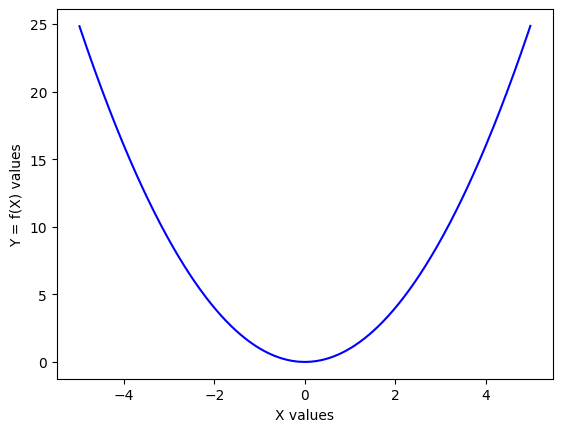

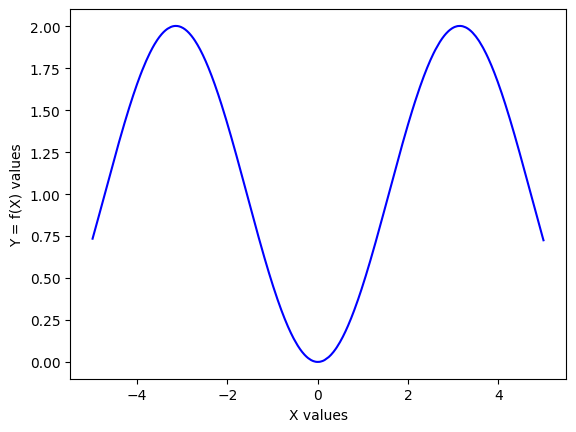

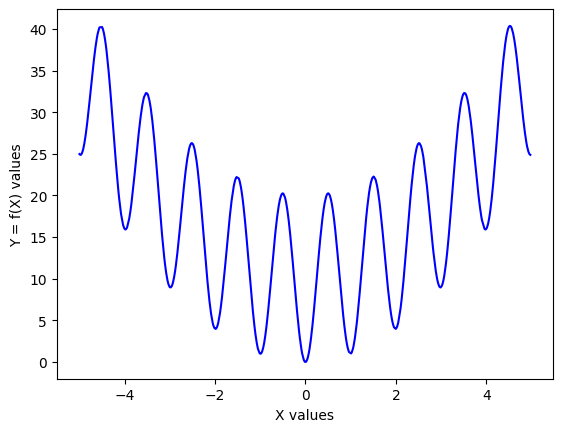

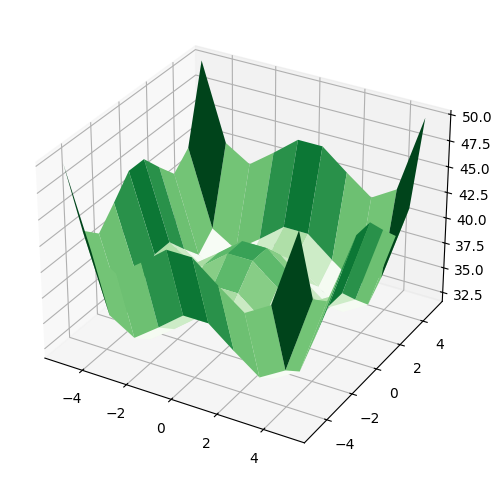

In [298]:
%run DataVizualisation.ipynb
%run Fitness.ipynb
%run OptimizationMethods.ipynb
import networkx as nx
import networkx as nx
import community.community_louvain as community_louvain
import scipy
import matplotlib.pyplot as plt

In [299]:
def binToInt(x):
    val=0
    for bit in x:
        val = val*2 + bit
    return val

In [300]:
def create_graph(nodes, edges):
    G = nx.Graph()
    for node_label, node_data in nodes.items():
        G.add_node(node_label, **node_data)
    for source, target in edges:
        G.add_edge(source, target)
    return G

In [301]:
def generateNewValue(lim1,lim2):
    return uniform(lim1,lim2)

In [302]:
from random import randint


class BinaryChromosome:
    def __init__(self, problemParams=None):
        self.__problParams = problemParams
        self.__repres = []
        for _ in range(problemParams['numNodes']):
            gene = [randint(0, 1) for _ in range(problemParams['numBits'])]
            self.__repres.append(gene)
        self.__fitness = 0.0

    @property
    def repres(self):
        realRepres = []
        maxint = 2 ** self.__problParams['numBits']
        for gene in self.__repres:
            intValue = binToInt(gene)
            realValue = self.__problParams['min'] + intValue / maxint * (self.__problParams['max'] - self.__problParams['min'])
            realRepres.append(realValue)
        return realRepres

    @property
    def fitness(self):
        return self.__fitness

    @repres.setter
    def repres(self, l=[]):
        self.__repres = l

    @fitness.setter
    def fitness(self, fit=0.0):
        self.__fitness = fit

    def crossover(self, other):
        noBits = self.__problParams['numBits']
        newRepres = []
        for geneM, geneF in zip(self.__repres, other.__repres):
            cuttingPoint = randint(0, noBits - 1)
            newGene = [geneM[i] if i < cuttingPoint else geneF[i] for i in range(noBits)]
            newRepres.append(newGene)
        offspring = BinaryChromosome(self.__problParams)
        offspring.repres = newRepres
        return offspring

    def mutation(self):
        gene = randint(0, len(self.__repres) - 1)
        bit = randint(0, len(self.__repres[0]) - 1)
        self.__repres[gene][bit] = 1 - self.__repres[gene][bit]

    def __str__(self):
        return f'\nChromo: {self.__repres} has fit: {self.__fitness}'

    def __repr__(self):
        return self.__str__()

    def __eq__(self, other):
        return self.__repres == other.__repres and self.__fitness == other.__fitness


In [303]:
class Chromosome:
    def __init__(self, problemParams):
        self.__problParams = problemParams
        self.__repres = [random.randint(0, problemParams['numCommunities'] - 1) for _ in range(problemParams['numNodes'])]
        self.__fitness = 0.0

    @property
    def repres(self):
        return self.__repres

    @property
    def fitness(self):
        return self.__fitness

    @repres.setter
    def repres(self, l):
        self.__repres = l

    @fitness.setter
    def fitness(self, fit):
        self.__fitness = fit

    def crossover(self, other):
        crossover_point = random.randint(0, len(self.__repres) - 1)
        offspring = Chromosome(self.__problParams)
        offspring.repres = self.__repres[:crossover_point] + other.repres[crossover_point:]
        return offspring

    def mutation(self):
        mutation_point = random.randint(0, len(self.__repres) - 1)
        self.__repres[mutation_point] = random.randint(0, self.__problParams['numCommunities'] - 1)

    def __str__(self):
        return f'Chromosome: {self.__repres} Fitness: {self.__fitness}'

    def __repr__(self):
        return self.__str__()

In [304]:
class GA:
    def __init__(self, param=None, problParam=None, fitness_function=None):
        self.__param = param
        self.__problParam = problParam
        self.__population = []
        self.__fitness_function = fitness_function
        self.__best_solution_per_gen = []

    @property
    def population(self):
        return self.__population

    def initialisation(self):
        for _ in range(self.__param['populationSize']):
            c = Chromosome(self.__problParam)
            self.__population.append(c)

    def evaluation(self):
        for c in self.__population:
            c.fitness = self.__fitness_function(c.repres, self.__problParam)

    def bestChromosome(self):
        return min(self.__population, key=lambda x: x.fitness)

    def worstChromosome(self):
        return max(self.__population, key=lambda x: x.fitness)

    def selection(self):
        pos1 = random.randint(0, self.__param['populationSize'] - 1)
        pos2 = random.randint(0, self.__param['populationSize'] - 1)
        if self.__population[pos1].fitness < self.__population[pos2].fitness:
            return self.__population[pos1]
        else:
            return self.__population[pos2]

    def oneGeneration(self):
        newPop = []
        for _ in range(self.__param['populationSize']):
            p1 = self.selection()
            p2 = self.selection()
            off = p1.crossover(p2)
            off.mutation()
            newPop.append(off)
        self.__population = newPop
        self.evaluation()
        best_chromo = self.bestChromosome()
        self.__best_solution_per_gen.append(best_chromo.fitness)

    def oneGenerationElitism(self):
        newPop = [self.bestChromosome()]
        for _ in range(self.__param['populationSize'] - 1):
            p1 = self.selection()
            p2 = self.selection()
            off = p1.crossover(p2)
            off.mutation()
            newPop.append(off)
        self.__population = newPop
        self.evaluation()
        self.__best_solution_per_gen.append(self.bestChromosome().fitness)

    def oneGenerationSteadyState(self):
        for _ in range(self.__param['populationSize']):
            p1 = self.selection()
            p2 = self.selection()
            off = p1.crossover(p2)
            off.mutation()
            off.fitness = self.__fitness_function(off.repres, self.__problParam)
            worst = self.worstChromosome()
            if off.fitness < worst.fitness:
                self.__population[self.__population.index(worst)] = off
        self.__best_solution_per_gen.append(self.bestChromosome().fitness)

    def get_best_solution_per_gen(self):
        return self.__best_solution_per_gen


In [305]:
def my_read_gml(file_path):
    G = nx.Graph()

    with open(file_path, 'r') as file:
        lines = file.readlines()

    is_node = False
    is_edge = False
    nodes = {}
    edges = set()
    node_id = None

    for line in lines:
        if line.strip().startswith("node"):
            is_node = True
            is_edge = False
            node_id = None
        elif line.strip().startswith("edge"):
            is_node = False
            is_edge = True
            source, target = None, None
        elif is_node:
            if line.strip().startswith("id"):
                node_id = int(line.strip().split()[1])
                nodes[node_id] = {}
        elif is_edge:
            if line.strip().startswith("source"):
                source = int(line.strip().split()[1])
            elif line.strip().startswith("target"):
                target = int(line.strip().split()[1])
            elif line.strip() == "]":
                if source is not None and target is not None:
                    edges.add((source, target))
            else:
                continue

    if min(nodes.keys()) == 0:
        # adaug 1 la toate nodurile si muchiile
        nodes = {k + 1: v for k, v in nodes.items()}
        edges = {(k + 1, v + 1) for k, v in edges}

    G.add_nodes_from(nodes.keys())
    G.add_edges_from(edges)

    return G

In [306]:

def read_edge_list_network(file_path):
    G = nx.Graph()
    with open(file_path, 'r') as file:
        lines = file.readlines()
    for line in lines:
        if not line.strip() or line.strip().startswith('%'):
            continue
        try:
            source, target = map(int, line.strip().split()[:2])  # Luați doar primele două valori
            G.add_edge(source, target)
        except ValueError:
            print(f"Ignorând linia: {line.strip()}. Nu poate fi parsată corect.")
            continue

    # tre sa adaug 1 la valoarea tuturor nodurilor si muchiilor
    nodes = G.nodes()
    edges = G.edges()
    if min(nodes) == 0:
        # fac ca nodurile sa inceapa de la 1
        mapping = {k: k + 1 for k in nodes}
        G = nx.relabel_nodes(G, mapping)
        # fac ca muchiile sa inceapa de la 1
        edges = {(k + 1, v + 1) for k, v in edges}
        G.add_edges_from(edges)

    return G

In [307]:
def read_gml(file):
    try:
        # Citește fișierul GML direct
        with open(file, 'r') as f:
            G = nx.parse_gml(f, label='id')
        print("Graph successfully read.")
        
        # Conversie la MultiGraph pentru a gestiona muchiile duplicate
        MG = nx.MultiGraph(G)
        
        # Asigură-te că fiecare nod are un atribut 'label' sau folosește 'id' ca 'label'
        for node in MG.nodes():
            if 'label' not in MG.nodes[node]:
                MG.nodes[node]['label'] = str(node)
        
        # Conversie înapoi la Graph pentru a elimina duplicatele
        G_unique = nx.Graph()
        for u, v, data in MG.edges(data=True):
            if not G_unique.has_edge(u, v):
                G_unique.add_edge(u, v, **data)
        
        return G_unique
    except Exception as e:
        print(f"Error reading GML file: {e}")
        raise

In [308]:

def plot_graph_with_communities(graph, partition):
    pos = nx.spring_layout(graph)  # Positions for all nodes
    communities = {}
    community_index = 0  # Index for community
    for community in partition.values():
        communities[community_index] = community
        community_index += 1

    colors = [plt.cm.tab20(i / len(communities)) for i in range(len(communities))]

    for community, color in zip(communities.values(), colors):
        nx.draw_networkx_nodes(graph, pos, nodelist=community, node_color=[color])
    nx.draw_networkx_edges(graph, pos)
    nx.draw_networkx_labels(graph, pos)
    plt.show()

In [288]:
def read_and_create_graph(file_path, is_gml=True):
    if is_gml:
        graph = my_read_gml(file_path)
    else:
        graph = read_edge_list_network(file_path)
    return graph

In [309]:

def analyze(file_path, isGML=True):
    graph = read_and_create_graph(file_path, isGML)
    print(f"Graph created with {len(graph.nodes)} nodes and {len(graph.edges)} edges.")
    # print(graph.nodes)

    # GA parameters
    gaParam = {'populationSize': 10, 'noGen': 100, 'pc': 0.8, 'pm': 0.1}
    problParam = {'numNodes': len(graph.nodes), 'numCommunities': 5, 'graph': graph}
    print(problParam['numNodes'])

    # Initialize GA with chosen fitness function
    fitness_function = modularity_fitness

    ga = GA(gaParam, problParam, fitness_function)
    ga.initialisation()
    ga.evaluation()

    allBestFitnesses = []
    allAvgFitnesses = []
    generations = []

    for g in range(gaParam['noGen']):
        allPotentialSolutionsX = [c.repres for c in ga.population]
        allPotentialSolutionsY = [c.fitness for c in ga.population]
        bestSolX = ga.bestChromosome().repres
        bestSolY = ga.bestChromosome().fitness
        allBestFitnesses.append(bestSolY)
        allAvgFitnesses.append(sum(allPotentialSolutionsY) / len(allPotentialSolutionsY))
        generations.append(g)

        ga.oneGeneration()

        bestChromo = ga.bestChromosome()
        print('Best solution in generation ' + str(g) + ' is: x = ' + str(bestChromo.repres) + ' f(x) = ' + str(bestChromo.fitness))

    plt.plot(generations, allBestFitnesses, 'ro', label='best')
    plt.plot(generations, allAvgFitnesses, 'bo', label='mean')
    plt.legend()
    plt.xlabel('Generation')
    plt.ylabel('Fitness')
    plt.title('Genetic Algorithm Performance')
    plt.show()

    # Plot the graph with communities
    bestChromo = ga.bestChromosome()
    communities = decode_communities(bestChromo.repres, problParam['numNodes'], min(graph.nodes))
    plot_graph_with_communities(graph, communities)


Graph created with 105 nodes and 441 edges.
105
Communities: {0: [1, 5, 8, 9, 11, 12, 16, 19, 20, 22, 23, 47, 49, 52, 63, 65, 67, 73, 78, 81, 83, 86, 91], 1: [13, 15, 26, 28, 29, 32, 33, 39, 41, 42, 43, 56, 58, 59, 60, 61, 71, 76, 92, 94, 95, 99], 2: [2, 3, 4, 17, 48, 55, 57, 70, 74, 77, 84, 89, 97, 100, 102, 103], 3: [6, 18, 25, 30, 34, 35, 38, 44, 46, 50, 51, 53, 72, 82, 87, 96, 101, 105], 4: [7, 10, 14, 21, 24, 27, 31, 36, 37, 40, 45, 54, 62, 64, 66, 68, 69, 75, 79, 80, 85, 88, 90, 93, 98, 104]}
Community List: [[1, 5, 8, 9, 11, 12, 16, 19, 20, 22, 23, 47, 49, 52, 63, 65, 67, 73, 78, 81, 83, 86, 91], [13, 15, 26, 28, 29, 32, 33, 39, 41, 42, 43, 56, 58, 59, 60, 61, 71, 76, 92, 94, 95, 99], [2, 3, 4, 17, 48, 55, 57, 70, 74, 77, 84, 89, 97, 100, 102, 103], [6, 18, 25, 30, 34, 35, 38, 44, 46, 50, 51, 53, 72, 82, 87, 96, 101, 105], [7, 10, 14, 21, 24, 27, 31, 36, 37, 40, 45, 54, 62, 64, 66, 68, 69, 75, 79, 80, 85, 88, 90, 93, 98, 104]]
Communities: {0: [1, 6, 14, 18, 25, 30, 37, 38, 39, 

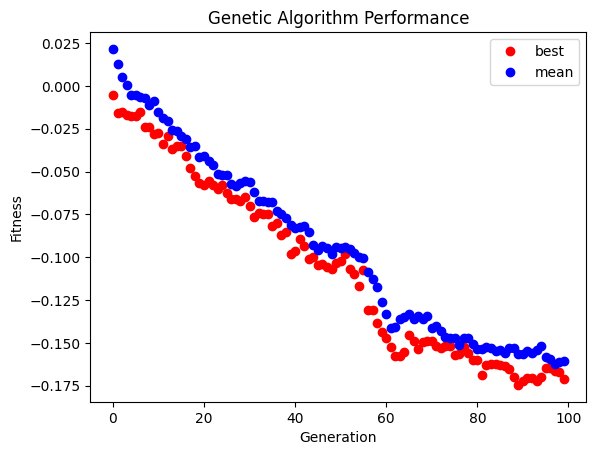

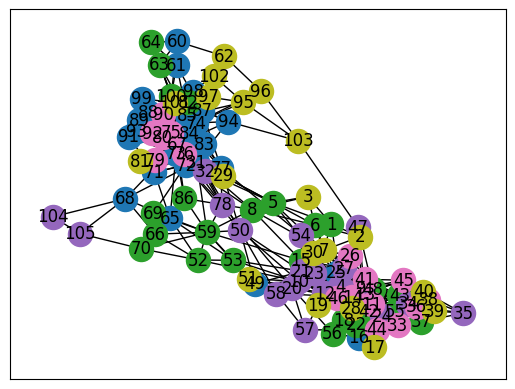

In [290]:
file_path = 'real_networks/krebs/krebs.gml'
analyze(file_path)


Graph created with 62 nodes and 159 edges.
62
Communities: {0: [4, 6, 8, 12, 14, 23, 27, 28, 36, 50, 53, 54, 62], 1: [2, 10, 16, 25, 29, 30, 35, 38, 41, 44, 48, 49], 2: [17, 18, 19, 20, 21, 24, 26, 31, 39, 45, 52, 55, 56, 58, 59], 3: [3, 5, 7, 13, 15, 22, 33, 42, 51], 4: [1, 9, 11, 32, 34, 37, 40, 43, 46, 47, 57, 60, 61]}
Community List: [[4, 6, 8, 12, 14, 23, 27, 28, 36, 50, 53, 54, 62], [2, 10, 16, 25, 29, 30, 35, 38, 41, 44, 48, 49], [17, 18, 19, 20, 21, 24, 26, 31, 39, 45, 52, 55, 56, 58, 59], [3, 5, 7, 13, 15, 22, 33, 42, 51], [1, 9, 11, 32, 34, 37, 40, 43, 46, 47, 57, 60, 61]]
Communities: {0: [1, 2, 3, 5, 10, 13, 15, 23, 27, 28, 29, 33, 39, 40, 41, 48, 61], 1: [6, 9, 11, 12, 21, 31, 38, 44, 45, 46, 52, 58, 59, 60], 2: [7, 16, 20, 24, 30, 36, 37, 42, 47, 50, 54, 55, 56, 57], 3: [4, 22, 25, 34, 35, 49], 4: [8, 14, 17, 18, 19, 26, 32, 43, 51, 53, 62]}
Community List: [[1, 2, 3, 5, 10, 13, 15, 23, 27, 28, 29, 33, 39, 40, 41, 48, 61], [6, 9, 11, 12, 21, 31, 38, 44, 45, 46, 52, 58, 59

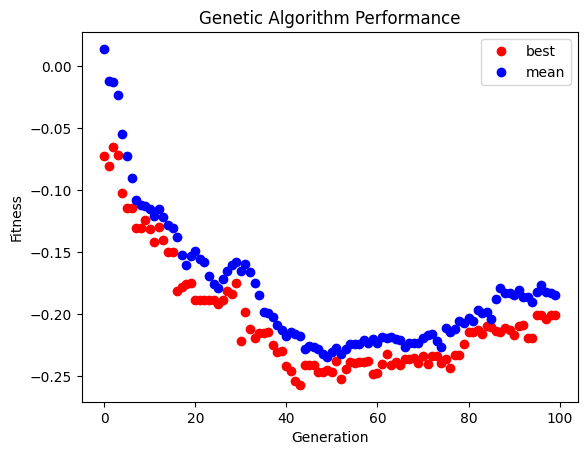

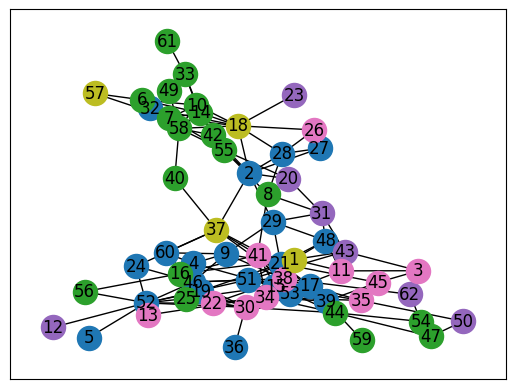

In [291]:
file_path= 'real_networks/dolphins/dolphins.gml'
analyze(file_path)

Graph created with 115 nodes and 613 edges.
115
Communities: {0: [6, 8, 10, 14, 27, 45, 48, 49, 55, 58, 68, 69, 75, 88, 90, 103, 110, 115], 1: [9, 11, 22, 24, 29, 33, 40, 42, 50, 57, 59, 64, 70, 72, 81, 96, 114], 2: [3, 12, 17, 18, 19, 20, 25, 31, 41, 56, 66, 67, 73, 77, 86, 87, 94, 95, 98, 106, 108, 109, 112], 3: [1, 4, 5, 7, 13, 15, 21, 28, 30, 34, 38, 39, 43, 44, 46, 47, 52, 61, 74, 78, 80, 85, 89, 91, 92, 93, 97, 100, 101, 107, 111, 113], 4: [2, 16, 23, 26, 32, 35, 36, 37, 51, 53, 54, 60, 62, 63, 65, 71, 76, 79, 82, 83, 84, 99, 102, 104, 105]}
Community List: [[6, 8, 10, 14, 27, 45, 48, 49, 55, 58, 68, 69, 75, 88, 90, 103, 110, 115], [9, 11, 22, 24, 29, 33, 40, 42, 50, 57, 59, 64, 70, 72, 81, 96, 114], [3, 12, 17, 18, 19, 20, 25, 31, 41, 56, 66, 67, 73, 77, 86, 87, 94, 95, 98, 106, 108, 109, 112], [1, 4, 5, 7, 13, 15, 21, 28, 30, 34, 38, 39, 43, 44, 46, 47, 52, 61, 74, 78, 80, 85, 89, 91, 92, 93, 97, 100, 101, 107, 111, 113], [2, 16, 23, 26, 32, 35, 36, 37, 51, 53, 54, 60, 62, 63, 

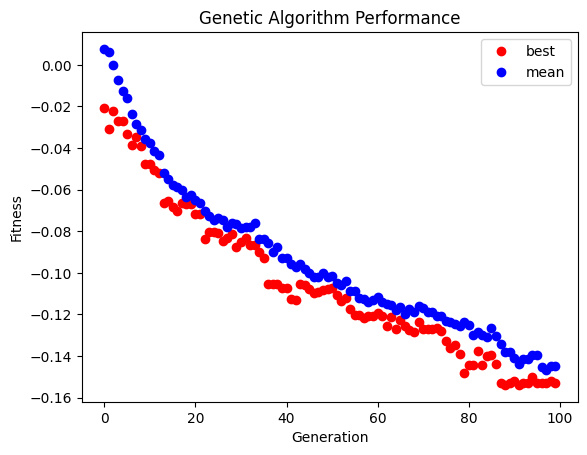

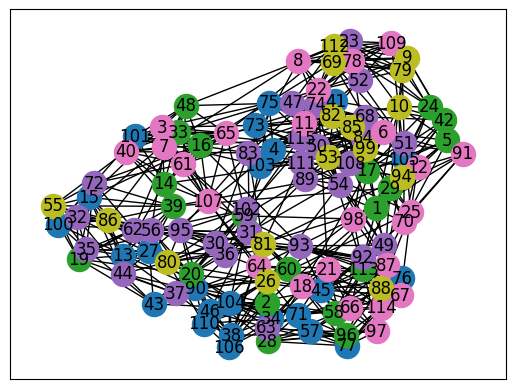

In [292]:
file_path= 'real_networks/football/football.gml'
analyze(file_path)

Graph created with 34 nodes and 78 edges.
34
Communities: {0: [1, 4, 6, 14, 26, 31, 32], 1: [2, 11, 12, 23, 29, 33], 2: [7, 8, 9, 13, 15, 16, 17, 20, 21, 22, 25, 27, 28], 3: [3, 10, 19, 24, 30], 4: [5, 18, 34]}
Community List: [[1, 4, 6, 14, 26, 31, 32], [2, 11, 12, 23, 29, 33], [7, 8, 9, 13, 15, 16, 17, 20, 21, 22, 25, 27, 28], [3, 10, 19, 24, 30], [5, 18, 34]]
Communities: {0: [3, 19, 23, 32], 1: [4, 8, 20, 24, 31, 34], 2: [2, 5, 6, 13, 14, 17, 22, 27, 29, 30], 3: [1, 10, 12, 28, 33], 4: [7, 9, 11, 15, 16, 18, 21, 25, 26]}
Community List: [[3, 19, 23, 32], [4, 8, 20, 24, 31, 34], [2, 5, 6, 13, 14, 17, 22, 27, 29, 30], [1, 10, 12, 28, 33], [7, 9, 11, 15, 16, 18, 21, 25, 26]]
Communities: {0: [4, 6, 9, 11, 17, 31, 33], 1: [1, 2, 12, 18, 20, 26, 32], 2: [5, 8, 13, 19, 24, 25, 27, 28, 29], 3: [3, 7, 10, 15], 4: [14, 16, 21, 22, 23, 30, 34]}
Community List: [[4, 6, 9, 11, 17, 31, 33], [1, 2, 12, 18, 20, 26, 32], [5, 8, 13, 19, 24, 25, 27, 28, 29], [3, 7, 10, 15], [14, 16, 21, 22, 23, 30, 

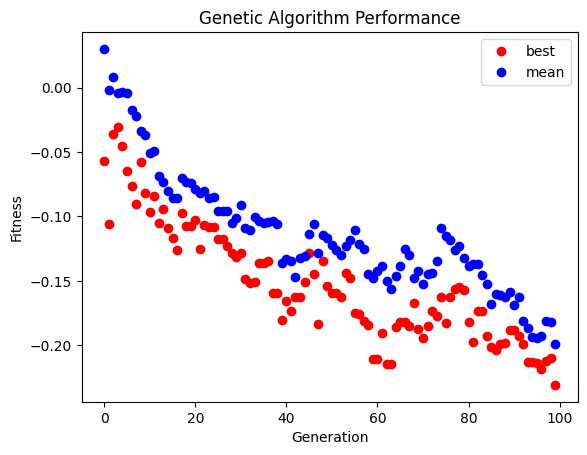

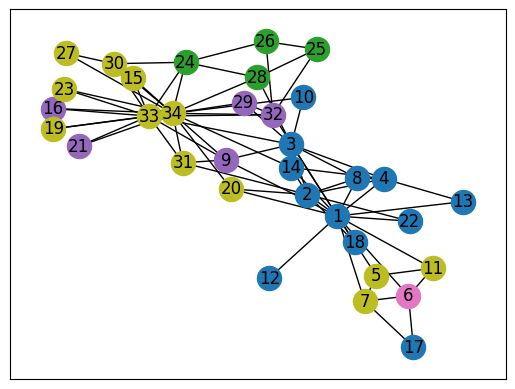

In [293]:
file_path= 'real_networks/karate/karate.gml'
analyze(file_path)

In [294]:
import tarfile
import requests
import shutil
import gzip
import os

def get_network(url, name_saved):
    response = requests.get(url)
    compressed_file_name = url.split("/")[-1]  # Extrage numele fișierului din URL

    # Salvează fișierul comprimat
    with open(compressed_file_name, "wb") as file:
        file.write(response.content)

    # Dezarhivează fișierul tar.gz
    if compressed_file_name.endswith('.tar.gz'):
        with tarfile.open(compressed_file_name, 'r:gz') as tar:
            tar.extractall(path=f"real_networks/mine/{name_saved}")
        extracted_path = f"real_networks/mine/{name_saved}"
    else:
        extracted_path = compressed_file_name

    # Listează fișierele extrase pentru verificare
    # print(f"Files extracted to {extracted_path}:")
    # for root, dirs, files in os.walk(extracted_path):
    #     for file in files:
    #         print(os.path.join(root, file))

    # Citirea și salvarea dataset-ului
    try:
        for root, dirs, files in os.walk(extracted_path):
            for file in files:
                if file.endswith(".edges") or file.endswith(".edgelist"):  # Folosim un fișier edges sau edgelist ca exemplu
                    edgelist_file_path = os.path.join(root, file)
                    G = nx.read_edgelist(edgelist_file_path, comments="#", delimiter=" ", create_using=nx.Graph(), nodetype=str)
                    nx.write_gml(G, f"real_networks/mine/{name_saved}.gml")
                    break  # Ne oprim după ce găsim primul fișier edges sau edgelist
    except Exception as e:
        print(f"An error occurred while processing the file {compressed_file_name}: {e}")

    # Șterge fișierele temporare
    if os.path.exists(compressed_file_name):
        os.remove(compressed_file_name)
    if os.path.exists(extracted_path) and extracted_path != compressed_file_name:
        shutil.rmtree(extracted_path)

Graph created with 5242 nodes and 14496 edges.
5242
Communities: {0: [2, 10, 11, 17, 29, 30, 48, 49, 52, 73, 74, 75, 80, 82, 85, 88, 94, 100, 112, 123, 140, 148, 150, 151, 156, 157, 158, 161, 169, 171, 176, 184, 185, 186, 190, 193, 205, 208, 219, 224, 228, 230, 232, 238, 239, 241, 244, 246, 249, 253, 255, 259, 265, 271, 281, 288, 290, 293, 294, 295, 296, 301, 302, 313, 321, 327, 331, 333, 349, 351, 360, 362, 374, 375, 377, 379, 386, 402, 443, 450, 452, 455, 457, 461, 463, 467, 480, 487, 488, 492, 495, 496, 497, 500, 506, 525, 533, 538, 542, 543, 545, 560, 593, 602, 610, 617, 618, 624, 626, 628, 630, 633, 637, 640, 642, 643, 644, 649, 654, 656, 660, 661, 664, 670, 673, 675, 678, 683, 695, 700, 704, 705, 707, 716, 721, 727, 730, 731, 735, 739, 742, 745, 749, 751, 757, 761, 763, 766, 777, 778, 788, 793, 801, 802, 809, 813, 815, 825, 827, 838, 844, 845, 848, 849, 863, 870, 872, 874, 880, 890, 906, 915, 918, 922, 925, 939, 947, 954, 958, 959, 960, 971, 981, 998, 1003, 1005, 1007, 1010, 1013

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Communities: {0: [1, 3, 6, 23, 25, 33, 36, 37, 41, 50, 51, 60, 71, 73, 75, 80, 90, 95, 97, 101, 102, 104, 112, 114, 119, 123, 124, 136, 137, 142, 146, 149, 156, 161, 163, 168, 178, 185, 187, 188, 195, 198, 199, 200, 205, 209, 212, 214, 215, 216, 221, 227, 248, 254, 256, 257, 261, 263, 265, 270, 272, 279, 281, 286, 287, 293, 295, 305, 330, 334, 335, 336, 338, 341, 362, 364, 368, 375, 389, 395, 401, 406, 409, 410, 416, 419, 421, 422, 425, 427, 428, 439, 445, 463, 468, 472, 475, 479, 489, 493, 501, 503, 505, 509, 510, 513, 514, 515, 516, 525, 528, 529, 533, 542, 545, 551, 560, 562, 570, 577, 583, 587, 590, 601, 614, 617, 621, 623, 644, 649, 651, 654, 659, 670, 673, 675, 688, 690, 700, 705, 709, 710, 740, 742, 751, 752, 761, 762, 764, 774, 776, 777, 780, 785, 797, 801, 805, 806, 808, 814, 827, 830, 835, 836, 837, 846, 854, 855, 859, 863, 879, 880, 881, 890, 893, 902, 906, 907, 911, 913, 914, 922, 926, 927, 928, 930, 931, 933, 938, 943, 945, 952, 960, 968, 973, 976, 977, 982, 986, 989, 990,

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Communities: {0: [1, 3, 6, 23, 25, 33, 36, 37, 41, 50, 51, 60, 71, 73, 75, 80, 90, 95, 97, 101, 102, 104, 112, 114, 119, 123, 124, 136, 137, 142, 146, 149, 156, 161, 163, 168, 178, 185, 187, 188, 195, 198, 199, 200, 205, 209, 212, 214, 215, 216, 221, 227, 248, 254, 256, 257, 261, 263, 265, 270, 272, 279, 281, 286, 287, 293, 295, 305, 330, 334, 335, 336, 338, 341, 362, 364, 368, 375, 389, 395, 401, 406, 409, 410, 416, 419, 421, 422, 425, 427, 428, 439, 445, 463, 468, 472, 475, 479, 489, 493, 501, 503, 505, 509, 510, 513, 514, 515, 516, 525, 528, 529, 533, 542, 545, 551, 560, 562, 570, 577, 583, 587, 590, 601, 614, 617, 621, 623, 644, 649, 651, 654, 659, 670, 673, 675, 688, 690, 700, 705, 709, 710, 740, 742, 751, 752, 761, 762, 764, 774, 776, 777, 780, 785, 797, 799, 801, 805, 806, 808, 814, 827, 830, 835, 836, 837, 846, 854, 855, 859, 863, 879, 880, 881, 890, 893, 902, 906, 907, 911, 913, 914, 922, 926, 927, 928, 930, 931, 933, 938, 943, 945, 952, 960, 968, 973, 976, 977, 982, 986, 989,

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Communities: {0: [1, 3, 6, 23, 25, 33, 36, 37, 41, 50, 51, 60, 71, 73, 75, 80, 90, 95, 97, 101, 102, 104, 112, 114, 119, 123, 124, 136, 137, 142, 146, 149, 156, 161, 163, 168, 178, 185, 187, 188, 195, 198, 199, 200, 205, 209, 212, 214, 215, 216, 221, 227, 248, 254, 256, 257, 261, 263, 265, 267, 270, 272, 279, 281, 286, 287, 293, 295, 305, 330, 334, 335, 336, 338, 341, 362, 364, 368, 375, 389, 395, 401, 406, 409, 410, 416, 419, 421, 422, 425, 427, 428, 439, 445, 463, 468, 472, 475, 479, 489, 493, 501, 503, 505, 509, 510, 513, 514, 515, 516, 525, 528, 529, 533, 542, 545, 551, 560, 562, 570, 577, 583, 587, 590, 601, 614, 617, 621, 623, 644, 649, 651, 654, 659, 670, 673, 675, 688, 690, 700, 705, 709, 710, 740, 742, 751, 752, 761, 762, 764, 774, 776, 777, 780, 785, 797, 799, 801, 805, 806, 808, 814, 827, 830, 835, 836, 837, 839, 846, 854, 855, 859, 863, 879, 880, 881, 890, 893, 902, 906, 907, 911, 913, 914, 922, 926, 927, 928, 930, 931, 933, 938, 943, 945, 952, 960, 966, 968, 973, 976, 977,

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Communities: {0: [1, 3, 6, 23, 25, 33, 36, 37, 41, 50, 51, 60, 71, 73, 75, 80, 90, 95, 97, 101, 102, 104, 112, 114, 119, 123, 124, 136, 137, 142, 146, 149, 156, 161, 168, 178, 185, 187, 188, 195, 198, 199, 200, 205, 209, 212, 214, 215, 216, 221, 227, 248, 254, 256, 257, 261, 263, 265, 267, 270, 272, 279, 281, 286, 287, 293, 295, 305, 330, 334, 335, 336, 338, 341, 362, 364, 368, 375, 389, 395, 401, 406, 409, 410, 416, 419, 421, 422, 425, 427, 428, 439, 445, 463, 468, 472, 475, 479, 489, 493, 503, 505, 509, 510, 513, 514, 515, 516, 525, 528, 529, 533, 542, 545, 551, 560, 562, 570, 577, 583, 587, 590, 601, 614, 617, 621, 623, 644, 649, 651, 654, 659, 670, 673, 675, 688, 690, 700, 705, 709, 710, 740, 742, 751, 752, 761, 762, 764, 774, 776, 777, 780, 785, 797, 799, 801, 805, 806, 808, 814, 827, 830, 835, 836, 837, 839, 846, 854, 855, 859, 863, 879, 880, 881, 890, 893, 902, 906, 907, 913, 914, 922, 926, 927, 928, 930, 931, 933, 938, 943, 945, 952, 960, 966, 968, 973, 976, 977, 982, 986, 989,

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



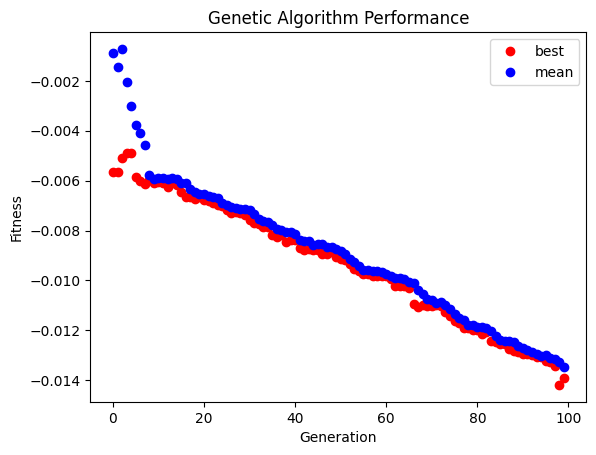

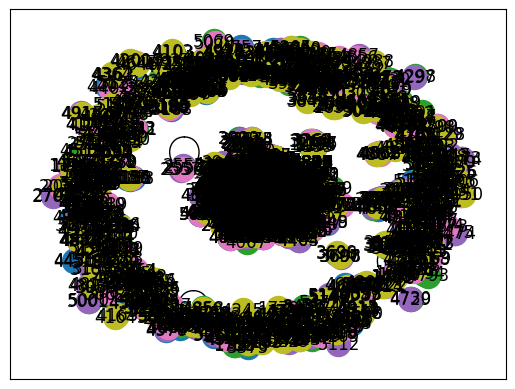

In [295]:
analyze('real_networks/mine/ca-GrQc.gml')

Graph created with 1174 nodes and 1417 edges.
1174
Best solution in generation 0 is: x = [2, 2, 0, 0, 3, 4, 0, 2, 3, 2, 2, 0, 0, 4, 0, 4, 1, 0, 2, 2, 4, 2, 0, 2, 2, 2, 3, 0, 3, 0, 0, 0, 3, 3, 3, 4, 3, 2, 3, 2, 3, 4, 1, 1, 2, 1, 4, 4, 0, 3, 3, 4, 3, 3, 4, 2, 1, 3, 3, 3, 0, 2, 2, 4, 4, 0, 4, 1, 3, 2, 3, 3, 3, 0, 1, 0, 0, 2, 0, 2, 2, 2, 0, 3, 3, 0, 0, 4, 4, 0, 1, 1, 2, 1, 0, 2, 2, 1, 3, 2, 3, 1, 3, 1, 4, 0, 0, 1, 2, 1, 4, 3, 3, 3, 4, 1, 1, 0, 0, 3, 0, 3, 4, 1, 0, 0, 3, 3, 3, 1, 2, 4, 1, 0, 1, 4, 3, 2, 2, 3, 3, 3, 0, 4, 2, 4, 2, 4, 0, 1, 1, 2, 4, 4, 2, 2, 1, 0, 3, 4, 2, 3, 1, 0, 1, 1, 0, 4, 3, 4, 1, 4, 2, 2, 1, 1, 2, 0, 4, 4, 2, 0, 0, 0, 3, 0, 3, 3, 3, 2, 3, 4, 2, 1, 4, 1, 0, 4, 4, 3, 3, 4, 3, 0, 3, 1, 4, 4, 4, 3, 4, 0, 2, 1, 3, 0, 4, 2, 3, 0, 4, 0, 1, 1, 0, 2, 2, 1, 4, 0, 2, 0, 3, 2, 4, 3, 0, 0, 3, 3, 3, 0, 2, 2, 4, 0, 2, 0, 3, 1, 0, 1, 3, 1, 4, 3, 4, 0, 3, 2, 3, 1, 2, 2, 2, 0, 1, 4, 3, 0, 4, 1, 1, 2, 0, 0, 0, 2, 1, 2, 0, 3, 2, 4, 3, 2, 2, 3, 1, 2, 0, 0, 0, 1, 4, 3, 2, 3, 4, 4, 1, 4, 3, 1

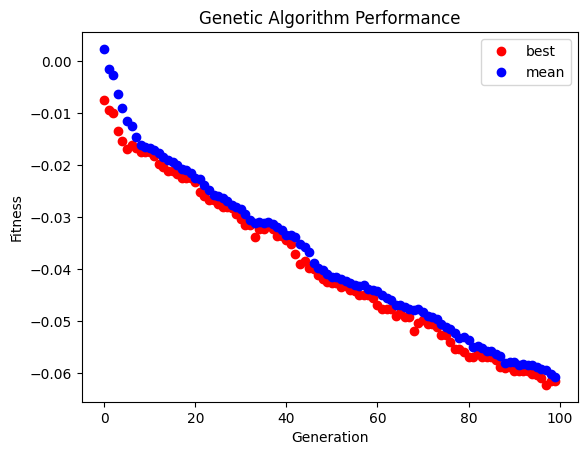

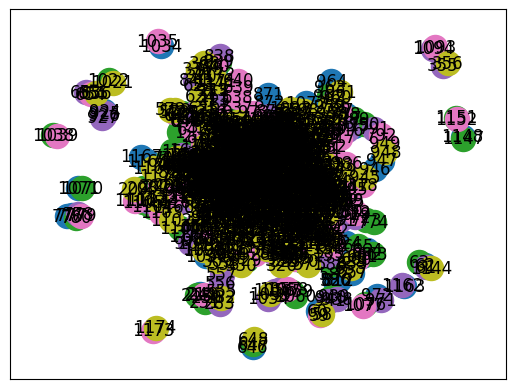

In [311]:
analyze('real_networks/mine/road-euroroad.edges', False)

Graph created with 37 nodes and 84 edges.
37
Best solution in generation 0 is: x = [3, 0, 1, 1, 1, 1, 2, 0, 0, 3, 0, 4, 2, 0, 3, 0, 0, 0, 3, 0, 4, 3, 4, 1, 4, 2, 4, 4, 3, 1, 0, 4, 2, 0, 1, 1, 1] f(x) = -0.027281746031746025
Best solution in generation 1 is: x = [0, 0, 3, 0, 0, 2, 2, 3, 4, 0, 3, 1, 1, 1, 0, 4, 2, 0, 4, 1, 1, 3, 4, 1, 2, 3, 1, 2, 3, 1, 1, 1, 4, 1, 4, 1, 4] f(x) = -0.03592687074829931
Best solution in generation 2 is: x = [0, 0, 3, 0, 0, 4, 2, 3, 2, 0, 3, 1, 1, 1, 0, 4, 2, 0, 4, 1, 1, 3, 4, 1, 2, 3, 1, 2, 3, 1, 1, 1, 4, 1, 4, 1, 4] f(x) = -0.03479308390022676
Best solution in generation 3 is: x = [0, 0, 3, 0, 0, 0, 2, 3, 2, 0, 3, 1, 1, 1, 0, 4, 2, 0, 4, 1, 1, 3, 4, 1, 2, 3, 1, 2, 3, 1, 1, 1, 4, 1, 4, 1, 4] f(x) = -0.05647675736961451
Best solution in generation 4 is: x = [0, 0, 3, 0, 0, 2, 3, 3, 2, 0, 3, 1, 1, 3, 0, 4, 2, 1, 4, 1, 1, 3, 1, 1, 2, 3, 1, 2, 1, 1, 3, 4, 4, 3, 4, 3, 0] f(x) = -0.09431689342403626
Best solution in generation 5 is: x = [0, 0, 3, 0, 0, 2, 1, 2, 3

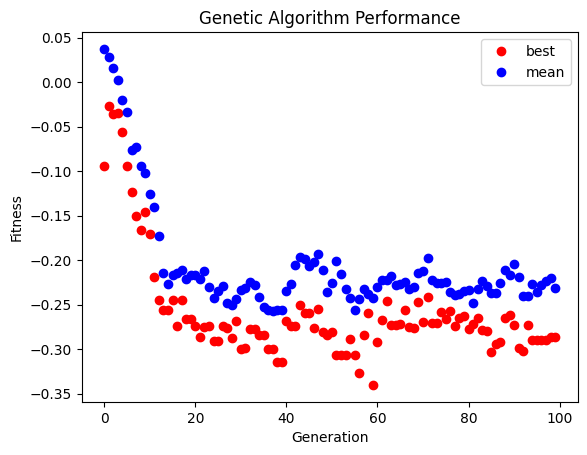

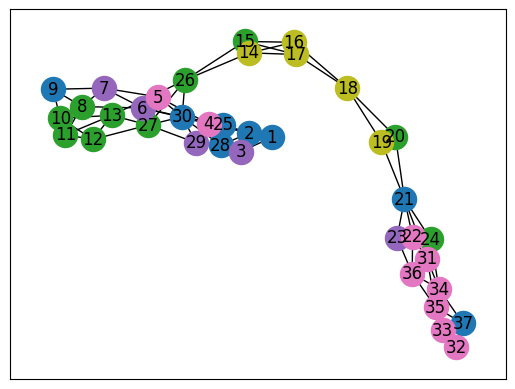

In [312]:
analyze('real_networks/mine/ENZYMES_g1.edges',False)

Graph created with 18772 nodes and 198110 edges.
18772
Best solution in generation 0 is: x = [1, 0, 4, 2, 0, 3, 0, 1, 3, 0, 2, 0, 4, 4, 4, 4, 0, 4, 2, 1, 1, 4, 2, 2, 3, 3, 2, 3, 3, 3, 3, 0, 0, 1, 1, 1, 2, 3, 0, 1, 3, 3, 0, 2, 1, 1, 0, 4, 1, 3, 0, 3, 2, 0, 1, 4, 3, 0, 2, 2, 0, 0, 2, 2, 1, 2, 0, 1, 0, 1, 4, 0, 0, 1, 1, 1, 3, 4, 3, 2, 4, 3, 2, 2, 3, 2, 3, 1, 0, 3, 4, 2, 2, 4, 2, 0, 2, 2, 4, 2, 4, 3, 1, 1, 3, 2, 1, 4, 0, 4, 3, 0, 0, 1, 3, 3, 4, 2, 4, 0, 0, 3, 2, 0, 1, 4, 4, 0, 1, 0, 0, 2, 4, 0, 0, 4, 1, 0, 3, 1, 2, 1, 0, 1, 4, 0, 3, 2, 0, 1, 4, 3, 0, 0, 4, 1, 1, 1, 3, 1, 2, 1, 4, 3, 3, 1, 2, 1, 4, 0, 2, 2, 1, 0, 3, 2, 2, 3, 2, 0, 3, 1, 4, 0, 1, 2, 4, 4, 4, 4, 0, 1, 4, 2, 0, 2, 4, 2, 4, 0, 3, 3, 1, 2, 0, 2, 1, 2, 4, 3, 3, 1, 4, 3, 3, 4, 0, 0, 3, 1, 1, 3, 4, 2, 1, 2, 3, 0, 2, 3, 1, 3, 0, 2, 0, 2, 2, 0, 0, 2, 1, 1, 0, 2, 0, 1, 4, 0, 4, 4, 2, 4, 1, 4, 3, 4, 0, 4, 4, 0, 0, 1, 4, 3, 4, 2, 3, 1, 0, 3, 0, 1, 1, 3, 0, 2, 3, 4, 3, 3, 0, 3, 2, 0, 2, 1, 3, 1, 4, 4, 1, 3, 0, 1, 0, 2, 0, 3, 3, 1, 2, 3, 

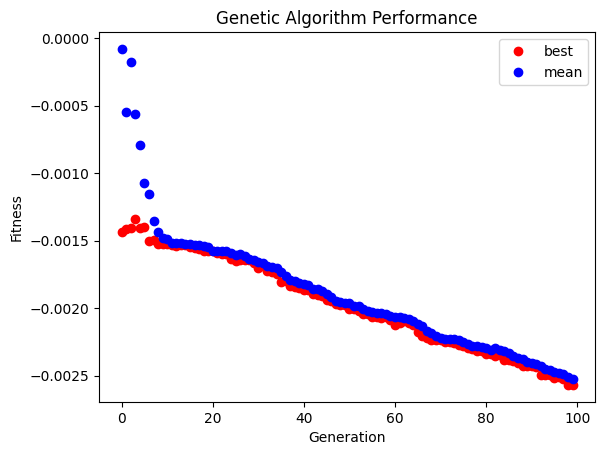

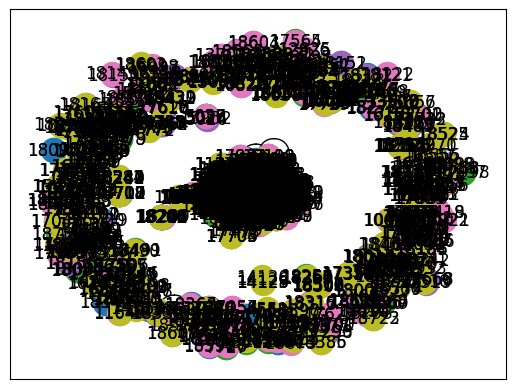

In [313]:
analyze('real_networks/mine/ca-AstroPh.gml')

Graph created with 24 nodes and 226 edges.
24
Best solution in generation 0 is: x = [4, 3, 1, 2, 3, 3, 1, 0, 4, 3, 4, 2, 4, 2, 0, 1, 0, 4, 4, 4, 2, 4, 4, 2] f(x) = 0.018756363066802378
Best solution in generation 1 is: x = [3, 4, 1, 2, 3, 2, 1, 2, 2, 0, 4, 0, 0, 0, 0, 0, 2, 4, 0, 4, 0, 1, 3, 4] f(x) = 0.0063924348030386
Best solution in generation 2 is: x = [1, 4, 1, 2, 1, 2, 1, 2, 2, 0, 4, 0, 0, 0, 0, 0, 2, 4, 0, 4, 0, 1, 3, 4] f(x) = 0.00721473882058109
Best solution in generation 3 is: x = [1, 4, 1, 2, 1, 2, 1, 2, 2, 0, 4, 0, 0, 0, 0, 0, 2, 4, 0, 4, 0, 1, 3, 4] f(x) = 0.00721473882058109
Best solution in generation 4 is: x = [1, 4, 1, 2, 1, 1, 1, 2, 1, 3, 4, 0, 0, 0, 0, 0, 2, 4, 0, 4, 0, 1, 3, 4] f(x) = 0.0031325867334951706
Best solution in generation 5 is: x = [1, 4, 0, 2, 1, 2, 1, 2, 2, 0, 4, 0, 0, 0, 0, 0, 2, 4, 0, 4, 0, 1, 3, 4] f(x) = -0.0009104080194220357
Best solution in generation 6 is: x = [1, 4, 0, 2, 1, 2, 1, 2, 2, 0, 4, 0, 0, 4, 0, 0, 0, 4, 4, 4, 0, 3, 4, 1] f(x) = -0.

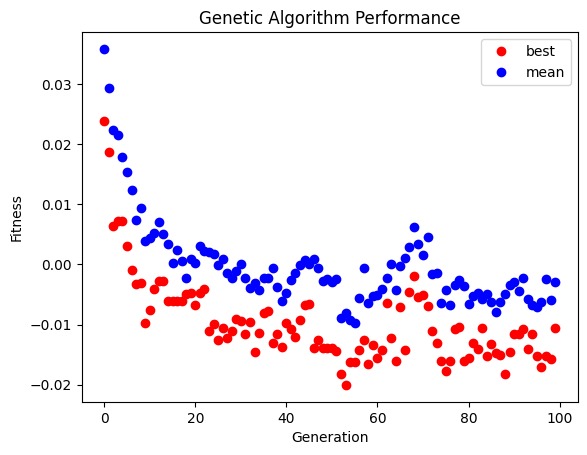

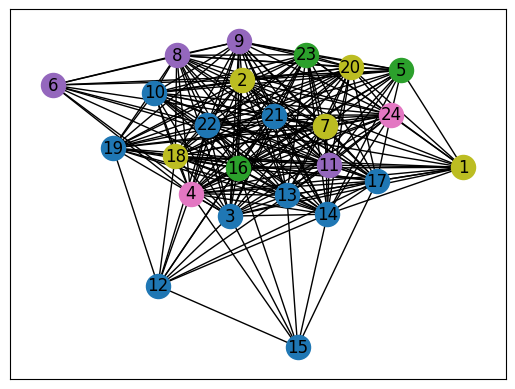

In [314]:
analyze('real_networks/mine/mammalia-raccoon-proximity.edges', False)

Graph created with 54 nodes and 353 edges.
54
Best solution in generation 0 is: x = [0, 0, 2, 0, 4, 3, 3, 4, 4, 0, 3, 0, 1, 3, 1, 0, 3, 3, 0, 0, 2, 1, 4, 2, 3, 3, 0, 4, 2, 4, 0, 4, 2, 4, 2, 3, 4, 2, 3, 1, 3, 4, 0, 0, 2, 3, 0, 1, 1, 3, 2, 4, 1, 1] f(x) = -0.028280461282892917
Best solution in generation 1 is: x = [0, 0, 2, 0, 4, 3, 3, 4, 4, 0, 3, 0, 1, 3, 1, 0, 3, 3, 0, 0, 2, 1, 4, 2, 3, 3, 0, 4, 2, 4, 0, 4, 2, 4, 2, 3, 4, 2, 3, 1, 3, 4, 0, 0, 2, 3, 0, 1, 1, 3, 2, 1, 1, 1] f(x) = -0.01945686106140008
Best solution in generation 2 is: x = [0, 3, 2, 0, 4, 3, 3, 4, 4, 0, 3, 0, 1, 3, 1, 0, 3, 3, 0, 0, 2, 1, 4, 2, 3, 3, 0, 4, 2, 4, 0, 4, 2, 4, 2, 3, 4, 2, 3, 1, 3, 4, 0, 0, 2, 3, 0, 1, 1, 3, 2, 1, 1, 1] f(x) = -0.013357783145679696
Best solution in generation 3 is: x = [0, 3, 2, 0, 4, 3, 1, 4, 1, 4, 0, 3, 0, 0, 0, 0, 3, 3, 0, 2, 2, 1, 4, 2, 3, 3, 0, 4, 2, 4, 0, 1, 2, 4, 2, 3, 4, 2, 3, 1, 3, 4, 0, 0, 2, 3, 0, 1, 1, 3, 2, 4, 1, 1] f(x) = -0.008374194480334503
Best solution in generation 4 is: x

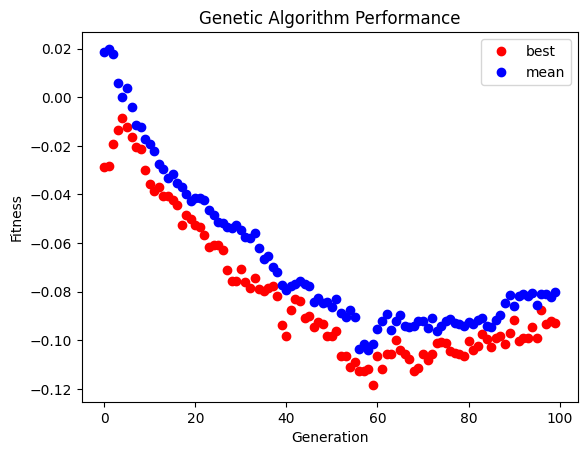

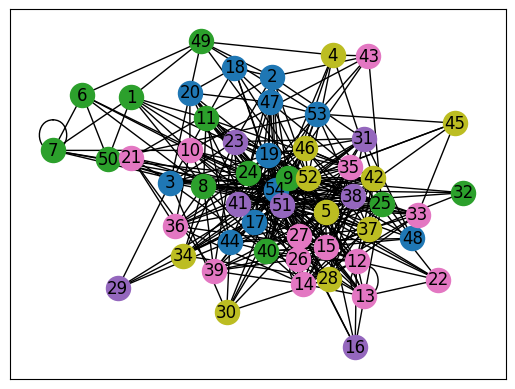

In [315]:
analyze('real_networks/mine/eco-stmarks.edges', False)

Graph created with 18 nodes and 78 edges.
18
Best solution in generation 0 is: x = [4, 2, 4, 4, 4, 4, 3, 4, 0, 1, 2, 2, 0, 2, 1, 4, 0, 2] f(x) = -0.16880341880341876
Best solution in generation 1 is: x = [4, 4, 4, 3, 1, 4, 3, 4, 0, 1, 2, 2, 0, 2, 1, 4, 0, 2] f(x) = -0.16904996712689022
Best solution in generation 2 is: x = [3, 4, 4, 3, 1, 4, 3, 4, 0, 1, 2, 2, 0, 2, 1, 4, 4, 2] f(x) = -0.1678172255095332
Best solution in generation 3 is: x = [3, 4, 4, 3, 3, 4, 3, 4, 0, 1, 2, 2, 0, 2, 1, 3, 4, 2] f(x) = -0.1934582511505588
Best solution in generation 4 is: x = [4, 3, 4, 4, 4, 1, 3, 1, 0, 2, 1, 2, 0, 2, 1, 3, 4, 2] f(x) = -0.17480276134122286
Best solution in generation 5 is: x = [4, 3, 4, 4, 4, 1, 3, 1, 0, 1, 2, 2, 0, 1, 2, 4, 3, 2] f(x) = -0.15212031558185402
Best solution in generation 6 is: x = [4, 3, 4, 4, 4, 1, 3, 2, 0, 2, 1, 2, 0, 2, 1, 1, 0, 2] f(x) = -0.1802268244575937
Best solution in generation 7 is: x = [4, 3, 4, 4, 4, 1, 3, 2, 0, 1, 1, 2, 0, 2, 1, 4, 0, 2] f(x) = -0.17611768

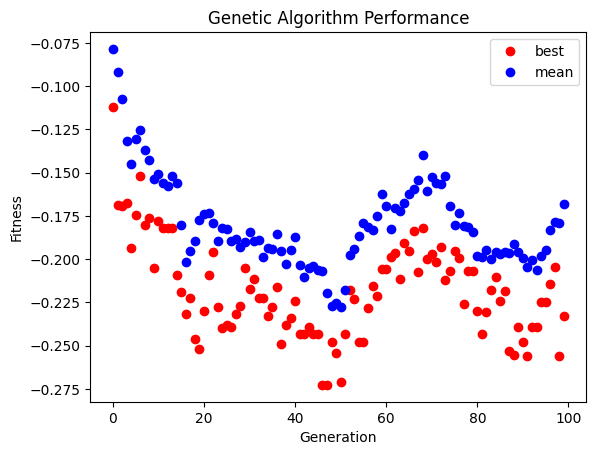

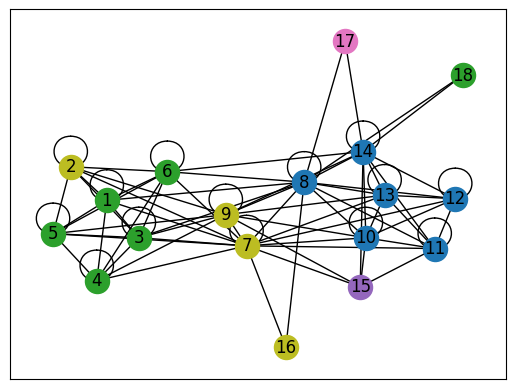

In [316]:
analyze('real_networks/mine/ia-southernwomen.edges', False)